## Advanced Lane Finding Project

The goals of this project are:
- Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
- Apply a distortion correction to raw images.
- Use color transforms, gradients, etc., to create a thresholded binary image.
- Apply a perspective transform to rectify binary image ("birds-eye view").
- Detect lane pixels and fit to find the lane boundary.
- Determine the curvature of the lane and vehicle position with respect to center.
- Warp the detected lane boundaries back onto the original image.
- Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

### Import required libraries

In [1]:
import numpy as np
import cv2
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import glob
import os
%matplotlib inline

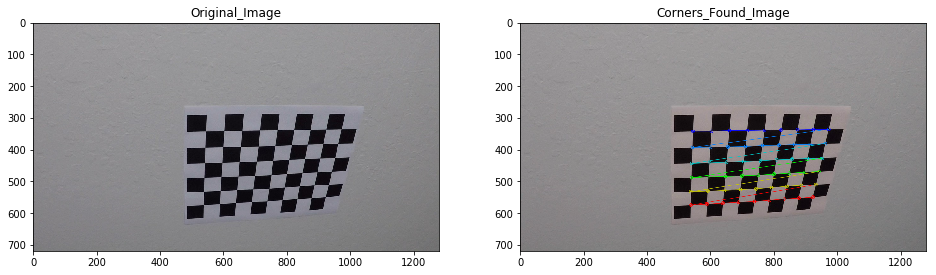

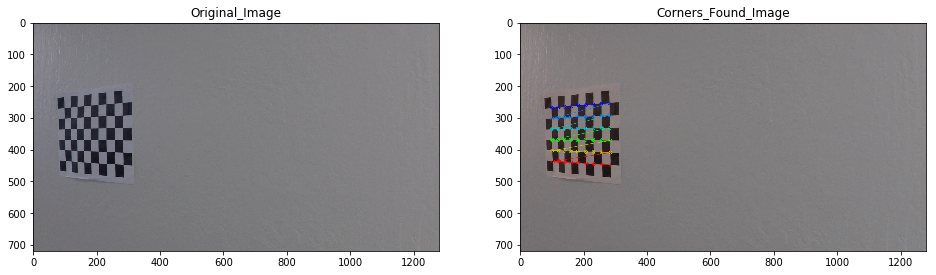

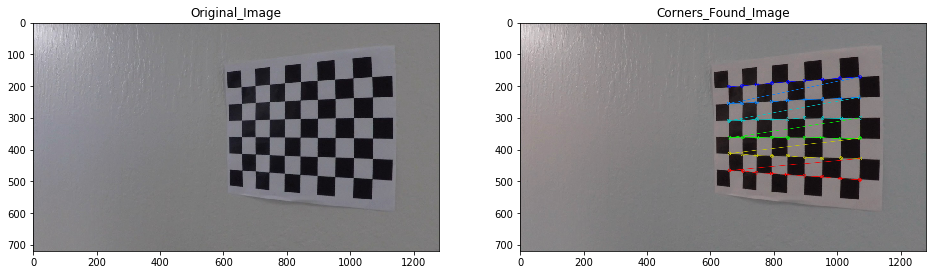

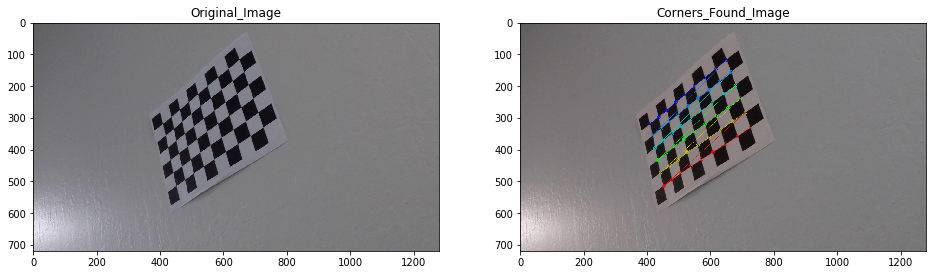

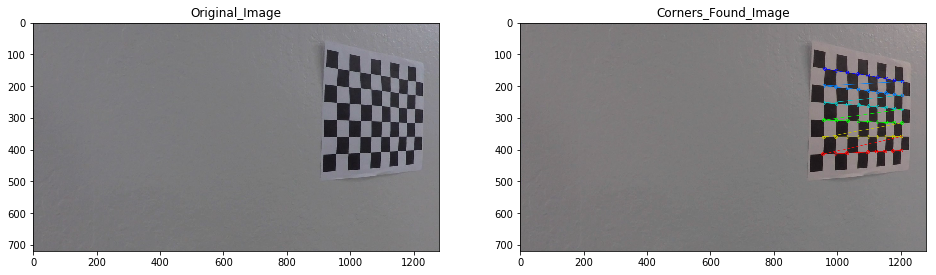

...

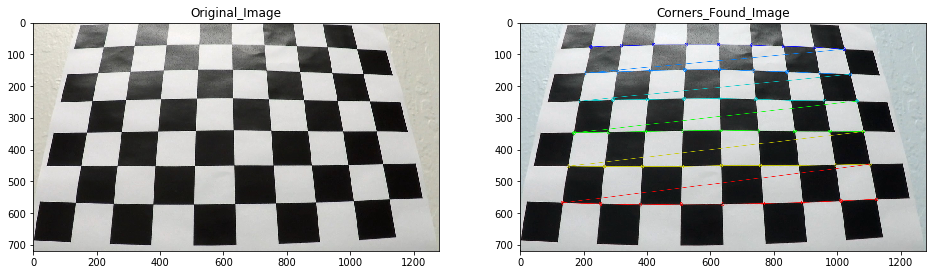

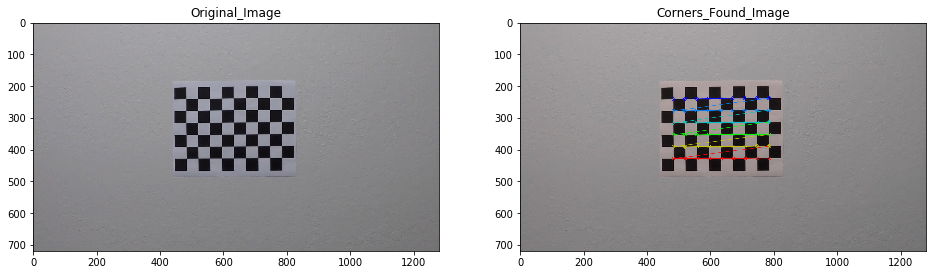

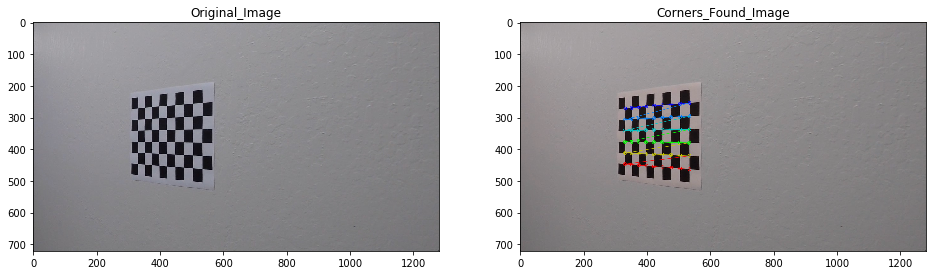

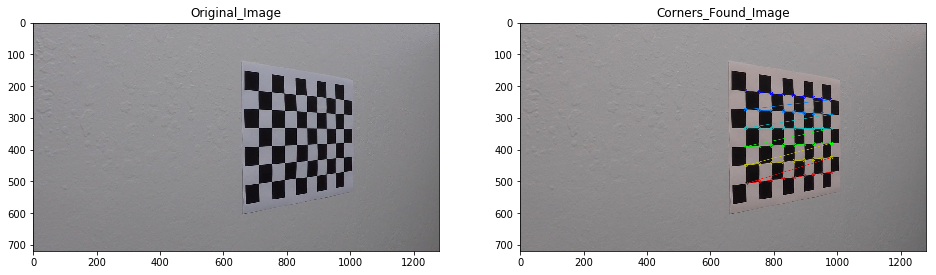

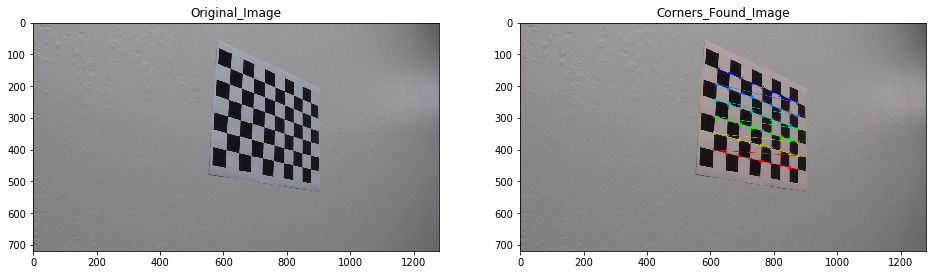

In [2]:
# Compute camera calibration using chessboard images

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space.
imgpoints = [] # 2d points in image plane.

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')
# print (images)
# Finding chessboard corners in above images
for image in images:
    img = cv2.imread(image)
    # grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)
    # print (ret)
    
    # If found
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        
        # Draw original and corner found images
        cv2.drawChessboardCorners(img, (9, 6), corners, ret)
        f, (axis1, axis2) = plt.subplots(1, 2, figsize=(16, 8))
        axis1.imshow(mpimg.imread(image))
        axis1.set_title('Original_Image')
        axis2.imshow(img)
        axis2.set_title('Corners_Found_Image')
        
#         plt.savefig('output_images/camera_cal/'+os.listdir('camera_cal/')[i-1])

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

### Image and Undistorted Images together

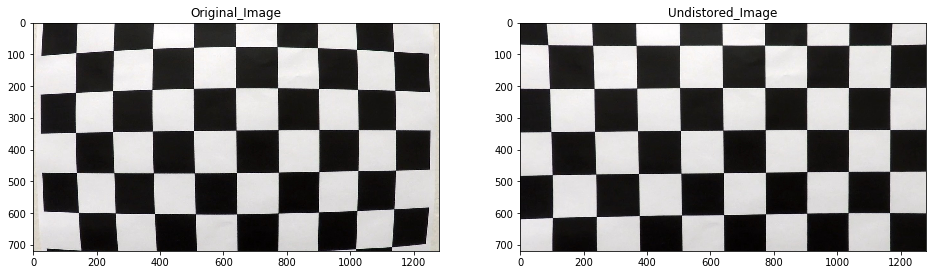

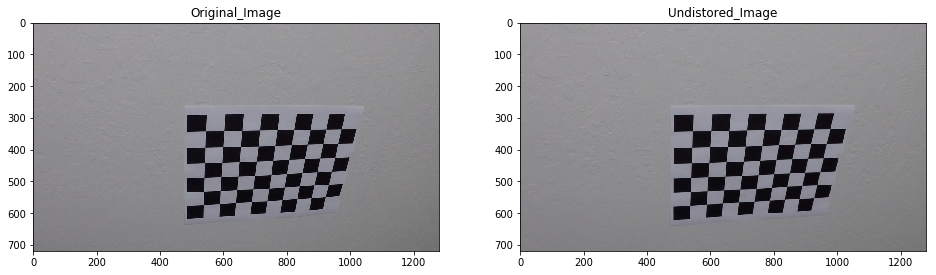

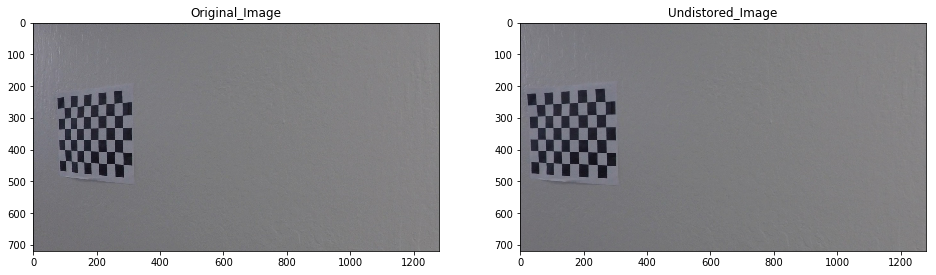

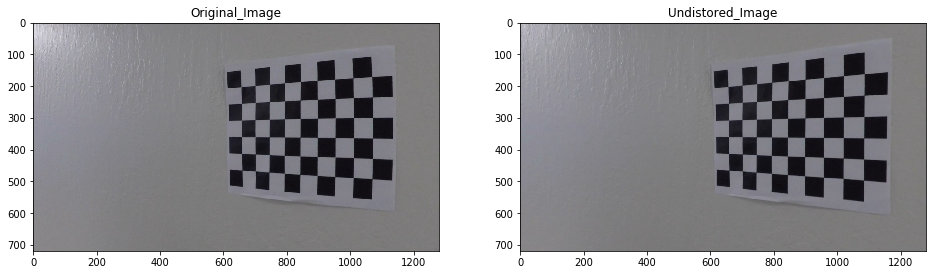

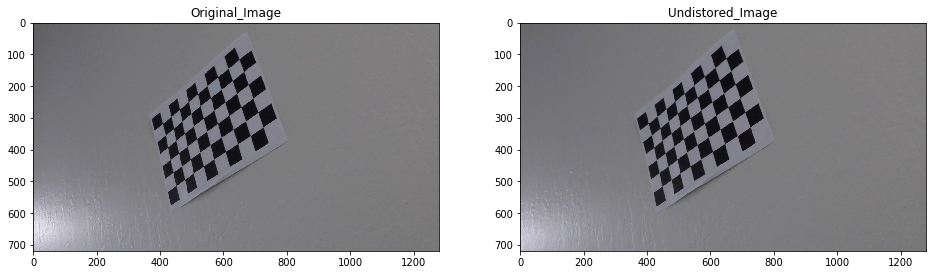

...

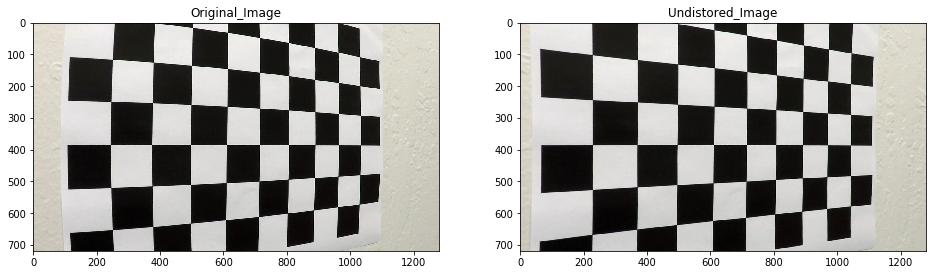

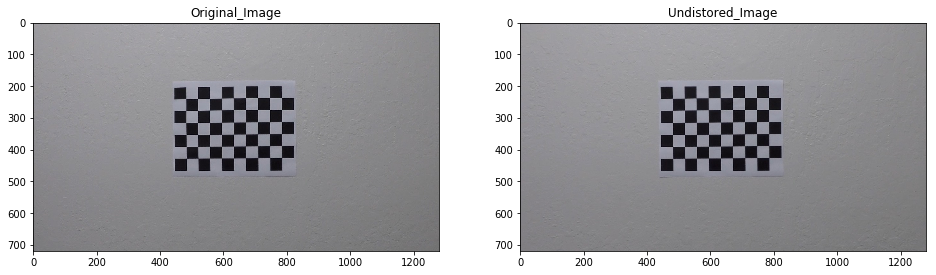

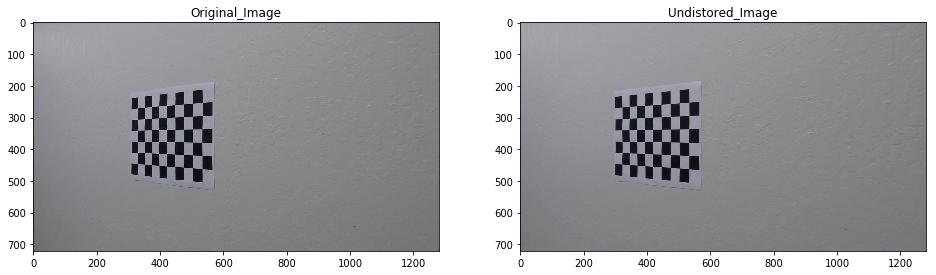

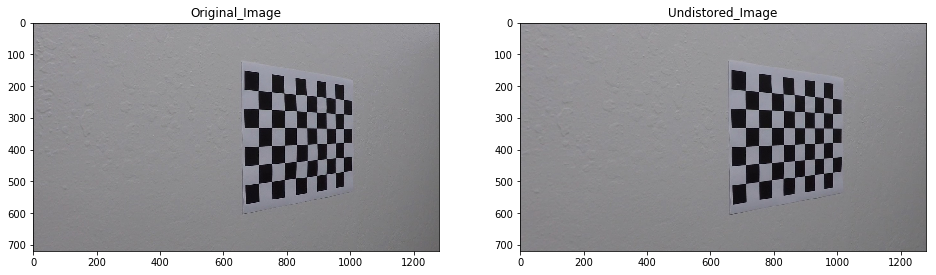

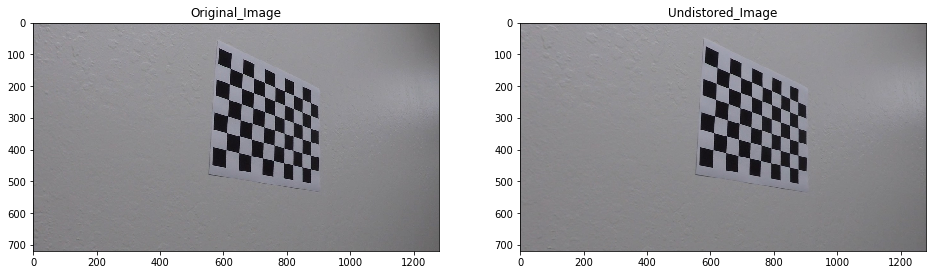

In [3]:
for image in images:
    img = mpimg.imread(image)
    f, (axis1, axis2) = plt.subplots(1, 2, figsize=(16, 8))
    axis1.imshow(img)
    axis1.set_title('Original_Image')
    # using cv2 fn to undistort the image
    u_img = cv2.undistort(img, mtx, dist, None, mtx)
    axis2.imshow(u_img)
    axis2.set_title('Undistored_Image')

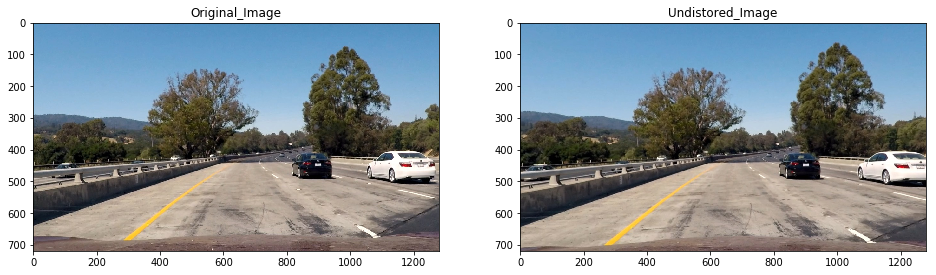

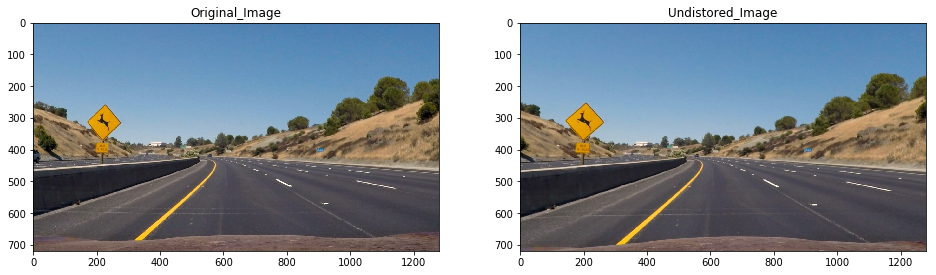

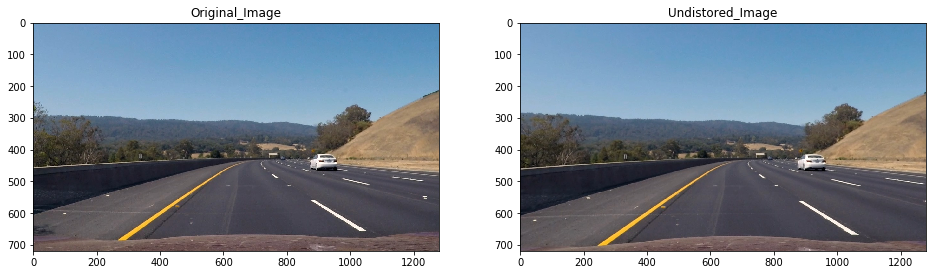

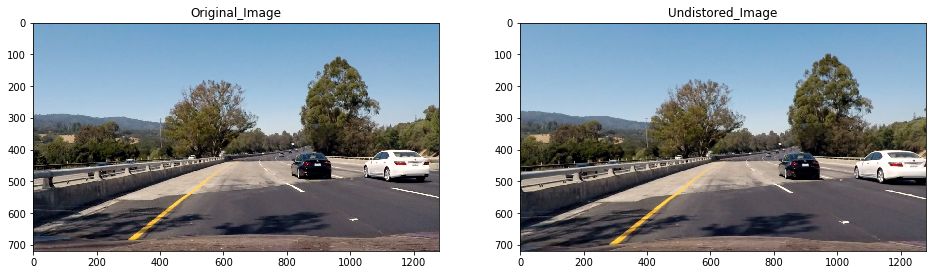

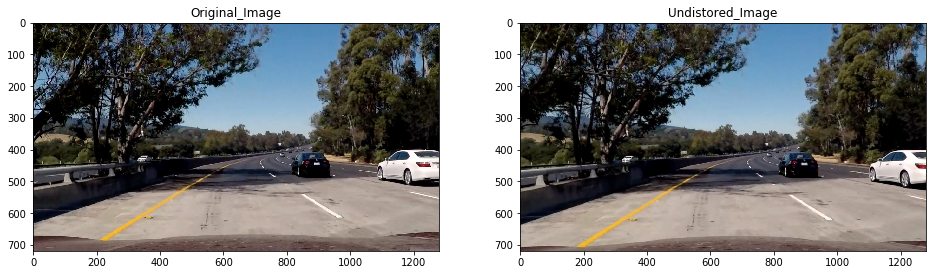

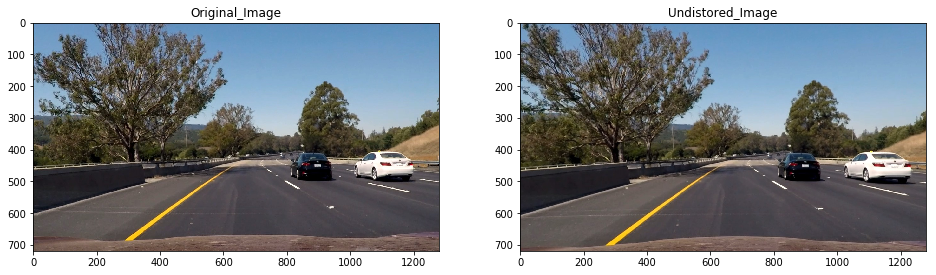

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [4]:
# Now applying on test images
test_images = glob.glob('./test_images/test*.jpg')

for image in test_images:
    img = mpimg.imread(image)
    u_img = cv2.undistort(img, mtx, dist, None, mtx)
    f, (axis1, axis2) = plt.subplots(1, 2, figsize=(16, 8))
    axis1.imshow(img)
    axis1.set_title('Original_Image')
    axis2.imshow(u_img)
    axis2.set_title('Undistored_Image')

### Use color transforms, gradients, etc., to create a thresholded binary image.


In [5]:
# def apply_process(image, s_thresh=(150, 255), sx_thresh=(30, 100)):
def apply_process(image, s_thresh=(160, 255), sx_thresh=(50, 100)):
    img = np.copy(image)
    # HLS color space conversion
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # select channels for threshold
    s_channel = hls[:,:,2]
    l_channel = hls[:,:,1]
    
    # Sobel X and threshold
    sobel_x = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobel_x = np.absolute(sobel_x) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255 * abs_sobel_x / np.max(abs_sobel_x))
    
    # Threshold
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Stack each channel
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    
    # Combine
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    return combined_binary

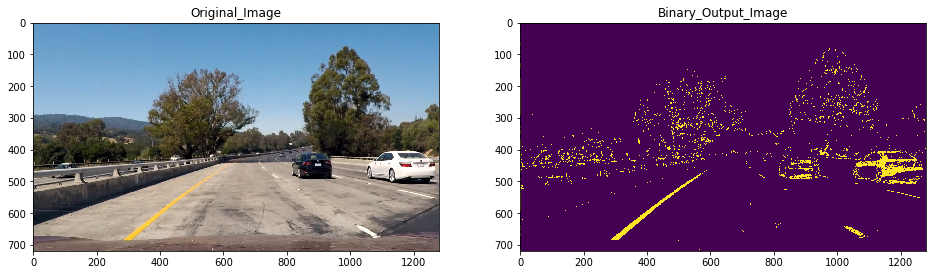

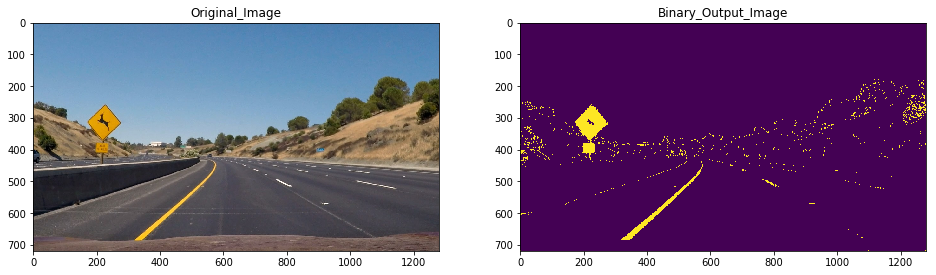

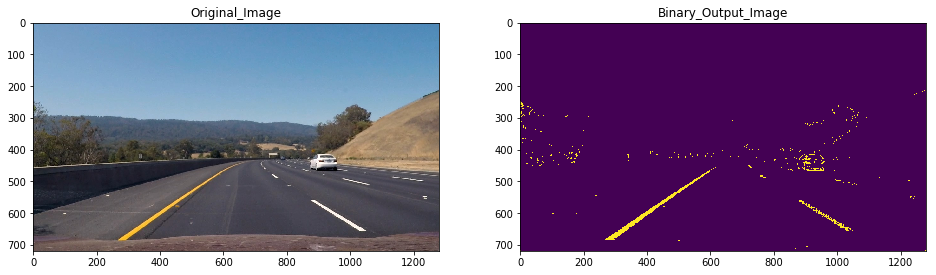

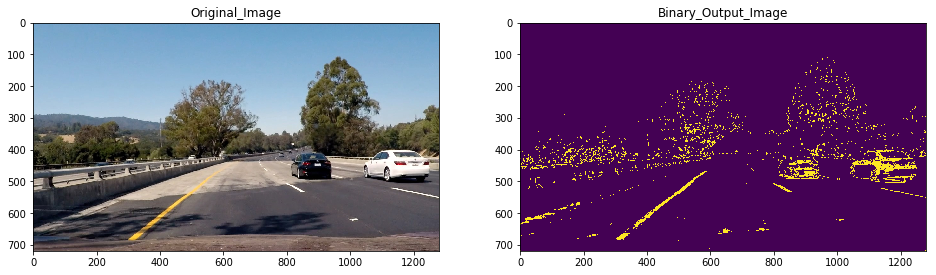

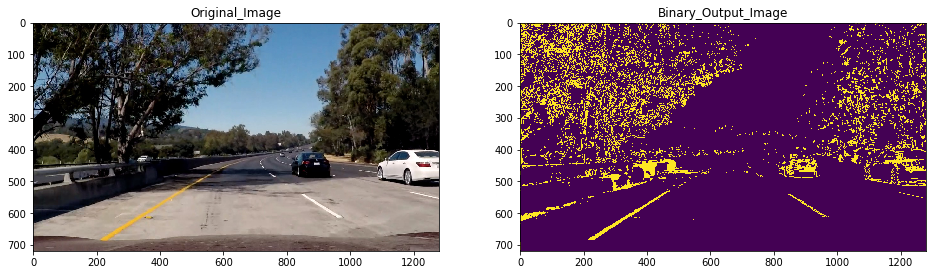

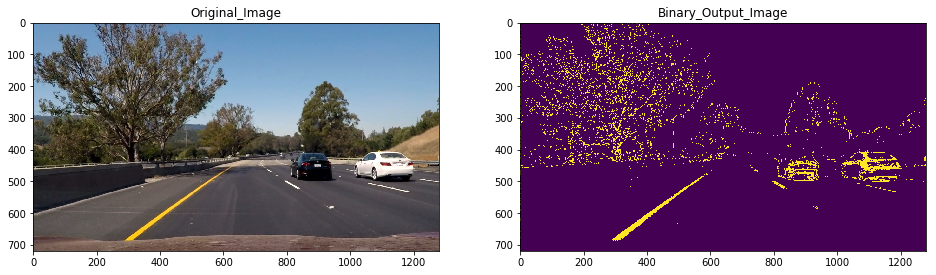

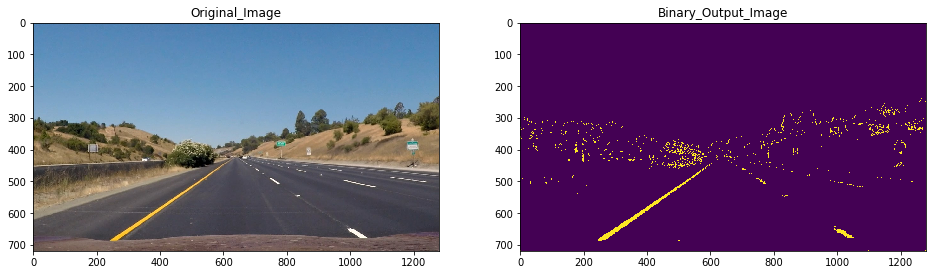

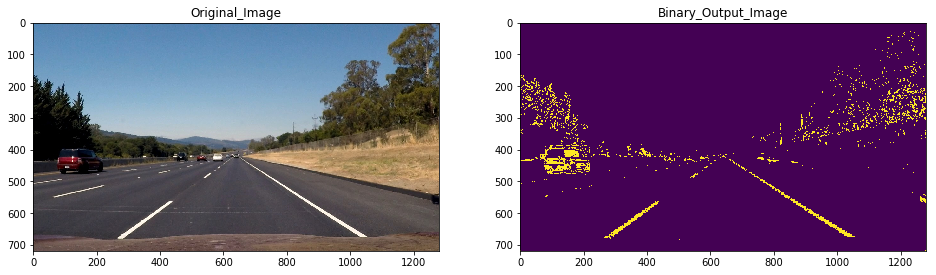

In [6]:
# apply on test images
test_images = glob.glob('./test_images/test*.jpg')

for image in test_images:
    img = mpimg.imread(image)
    b_img = apply_process(img)
    f, (axis1, axis2) = plt.subplots(1, 2, figsize=(16, 8))
    axis1.imshow(img)
    axis1.set_title('Original_Image')
    axis2.imshow(b_img)
    axis2.set_title('Binary_Output_Image')
    

### Applying Perspective Transform

In [7]:
def perspective_transform(image):
    img_shape = image.shape
    
    src = np.float32([[500, 480], [810, 480], [1240, 720], [40, 720]])
    dest = np.float32([[0, 0], [1270, 0], [1240, 720], [40, 720]])
    
    get_trans = cv2.getPerspectiveTransform(src, dest)
    get_trans_inv = cv2.getPerspectiveTransform(dest, src)
    
    w_image = cv2.warpPerspective(image, get_trans, (img_shape[1], img_shape[0]), flags = cv2.INTER_LINEAR)
    
    return w_image

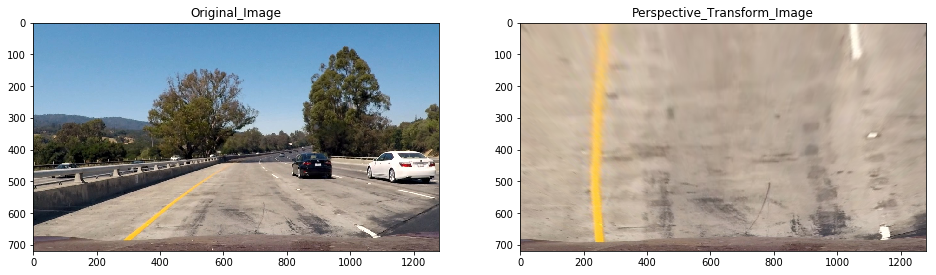

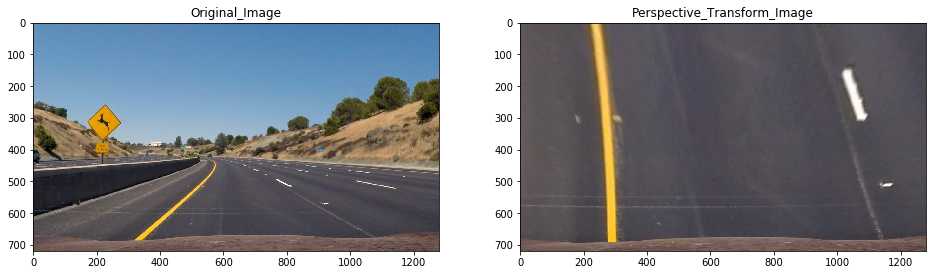

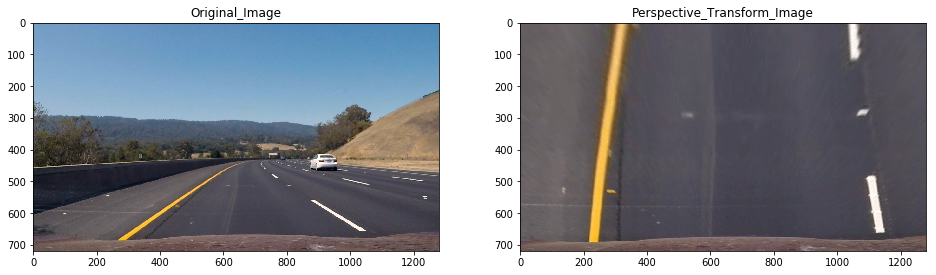

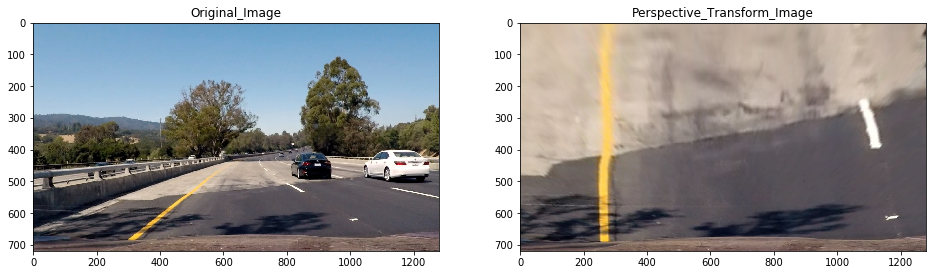

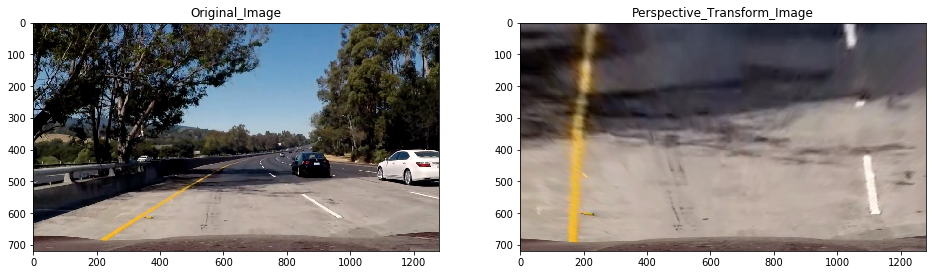

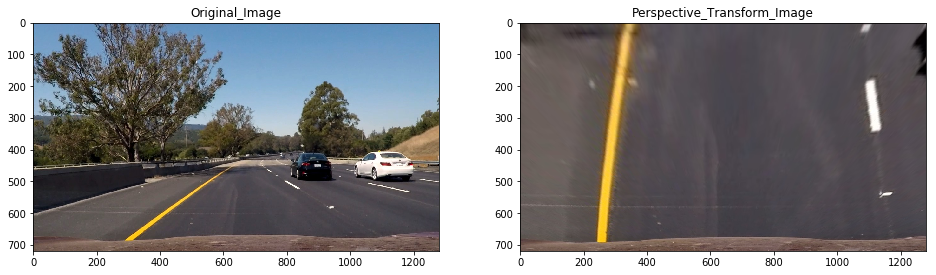

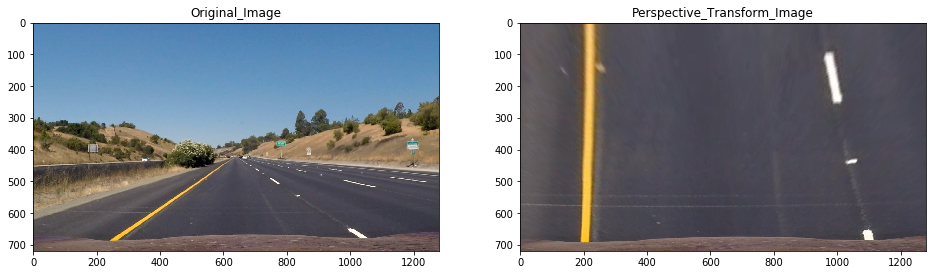

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [8]:
# apply to all test images
test_images = glob.glob('./test_images/test*.jpg')

for image in test_images:
    img = mpimg.imread(image)
    pt_img = perspective_transform(img)
    f, (axis1, axis2) = plt.subplots(1, 2, figsize=(16, 8))
    axis1.imshow(img)
    axis1.set_title('Original_Image')
    axis2.imshow(pt_img)
    axis2.set_title('Perspective_Transform_Image')

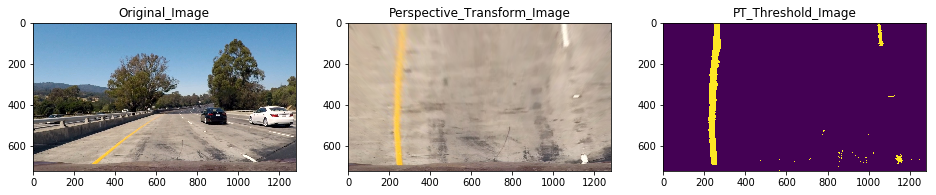

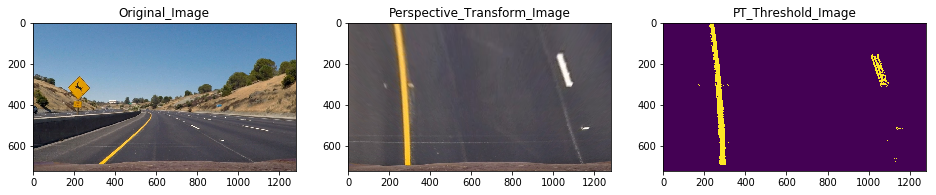

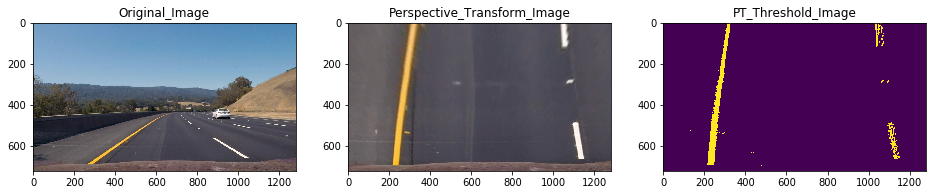

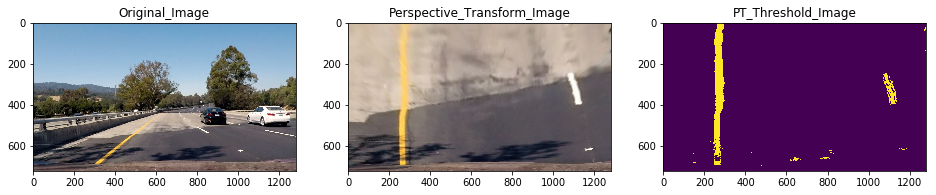

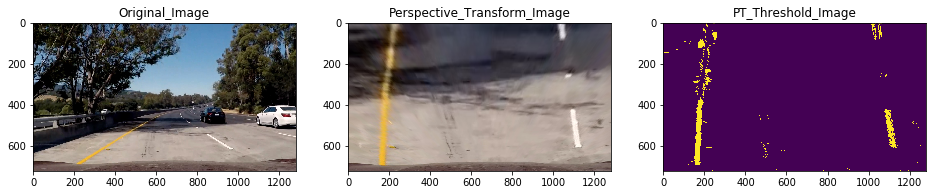

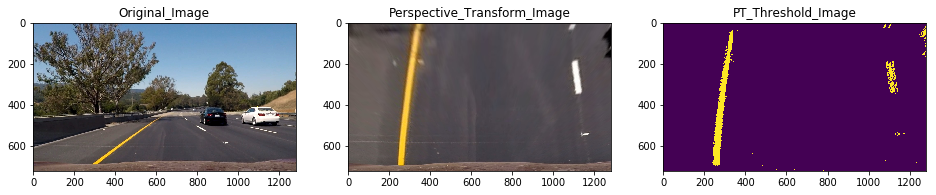

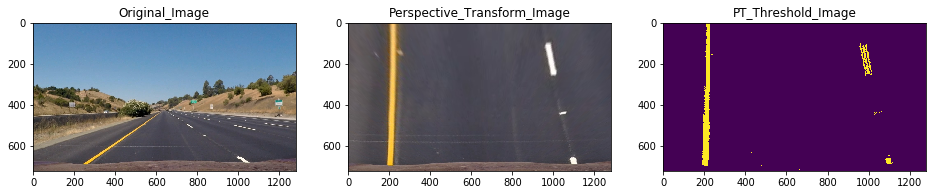

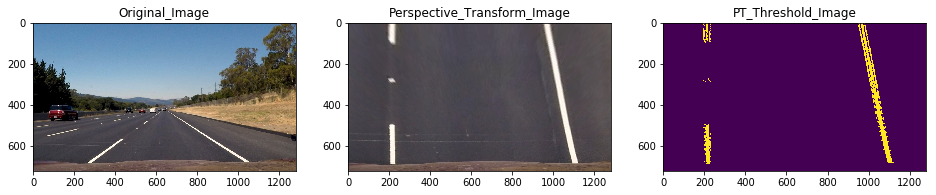

In [9]:
# Combine perspective transform with the color threshold from above

test_images = glob.glob('./test_images/test*.jpg')

for image in test_images:
    img = mpimg.imread(image)
    pt_img = perspective_transform(img)
    c_img = apply_process(perspective_transform(img))
    f, (axis1, axis2, axis3) = plt.subplots(1, 3, figsize=(16, 8))
    axis1.imshow(img)
    axis1.set_title('Original_Image')
    axis2.imshow(pt_img)
    axis2.set_title('Perspective_Transform_Image')
    axis3.imshow(c_img)
    axis3.set_title('PT_Threshold_Image')

### Sliding Window Implementation

In [10]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')

    return left_fitx, right_fitx, left_fit, right_fit, out_img, ploty


# out_img = fit_polynomial(binary_warped)

# plt.imshow(out_img)

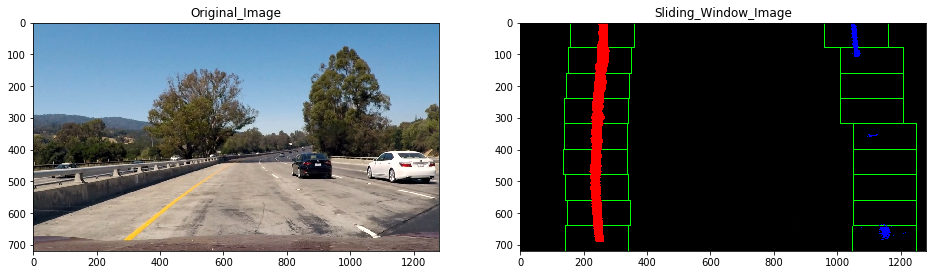

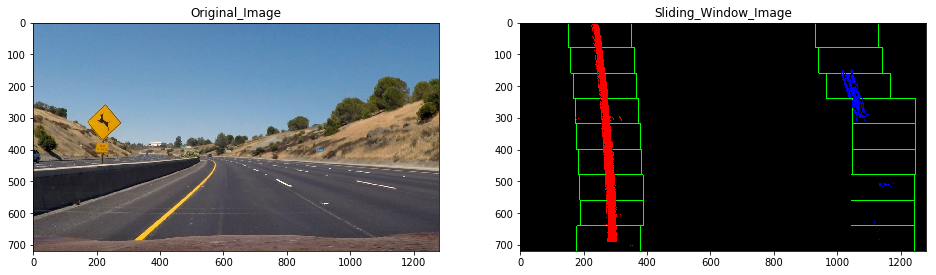

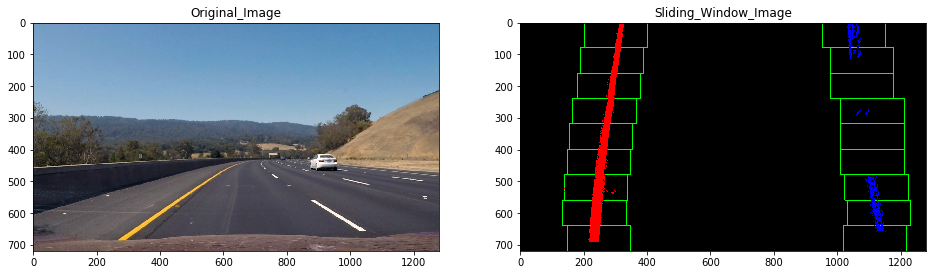

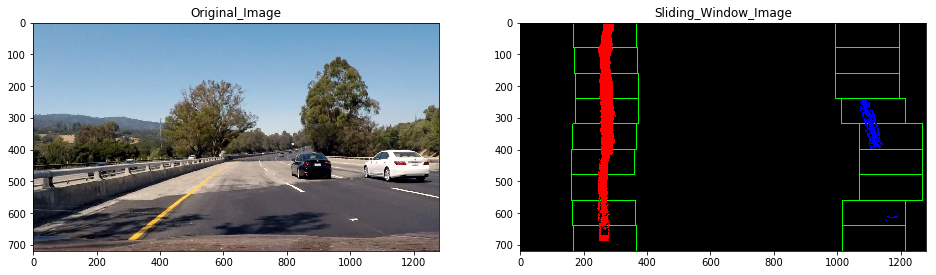

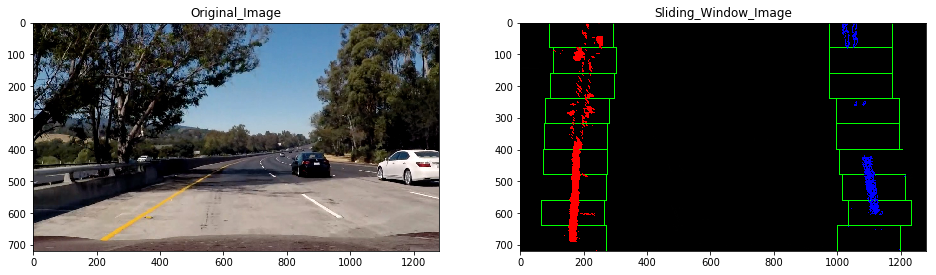

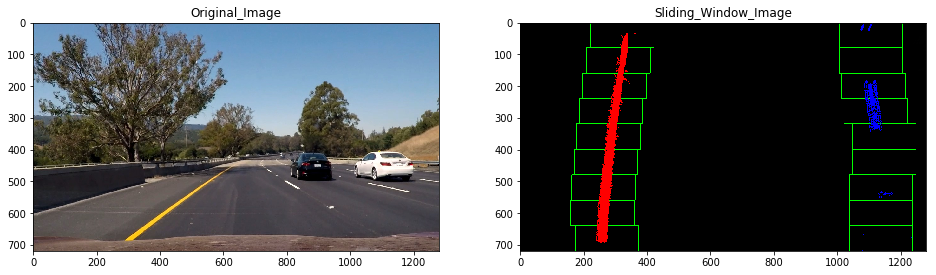

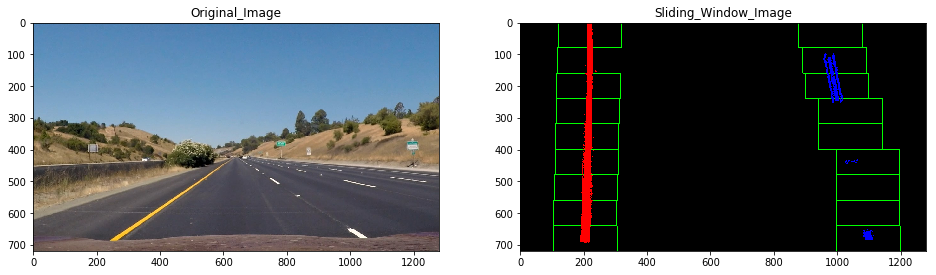

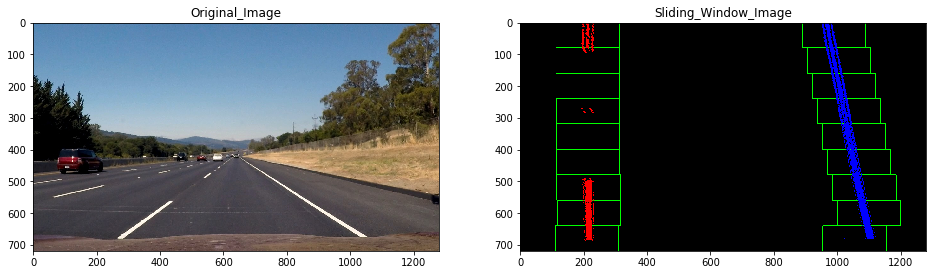

In [11]:
test_images = glob.glob('./test_images/test*.jpg')

for image in test_images:
    img = mpimg.imread(image)
    pt_img = perspective_transform(img)
    c_img = apply_process(perspective_transform(img))
    left_fitx, right_fitx, left_fit, right_fit, sw_img, ploty = fit_polynomial(c_img)
    f, (axis1, axis2) = plt.subplots(1, 2, figsize=(16, 8))
    axis1.imshow(img)
    axis1.set_title('Original_Image')
    axis2.imshow(sw_img)
    axis2.set_title('Sliding_Window_Image')

In [12]:
# Finding Curvature of lane
# Position vehicle with respect to center


def measure_curvature_real(left_fitx, right_fitx, left_fit, right_fit, ploty):
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    leftx = left_fitx * xm_per_pix
    rightx = right_fitx * xm_per_pix
    ploty = ploty * ym_per_pix    
    
    # Start by generating our fake example data
    # Make sure to feed in your real data instead in your project!
    # ploty, left_fit_cr, right_fit_cr = generate_data(ym_per_pix, xm_per_pix)
    
    left_fit_cr = np.polyfit(ploty, leftx, 2)
    right_fit_cr = np.polyfit(ploty, rightx, 2)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return left_curverad, right_curverad

def find_curvature_position_vehicle(image):
    img = np.copy(image)
    
    # apply above methods
    pt_img = perspective_transform(img)
    c_img = apply_process(perspective_transform(img))
    left_fitx, right_fitx, left_fit, right_fit, out_img, ploty = fit_polynomial(c_img)
    
    left_curverad, right_curverad = measure_curvature_real(left_fitx, right_fitx, left_fit, right_fit, ploty)
    
#     print ('Left curverad: ', left_curverad, ' Right curverad: ', right_curverad)
    
    leftx_int = left_fit[0]*720**2 + left_fit[1]*720 + left_fit[2]
    rightx_int = right_fit[0]*720**2 + right_fit[1]*720 + right_fit[2]
    h, w = out_img.shape[:2]
    center = abs(w/2 - ((rightx_int+leftx_int)/2))
    center = center*3.7/700
    
    src = np.float32([[500, 480], [810, 480], [1240, 720], [40, 720]])
    dest = np.float32([[0, 0], [1270, 0], [1240, 720], [40, 720]])
    
    Minv = cv2.getPerspectiveTransform(dest, src)
    
    warp_new = cv2.warpPerspective(out_img, Minv, (c_img.shape[1], c_img.shape[0]), flags = cv2.INTER_LINEAR)
    
    result = cv2.addWeighted(img, 1, warp_new, 0.5, 0)
    
    # print distance from center
#     if position > 640:
    cv2.putText(result, 'Vehicle is {:.2f}m left of center'.format(center), (100, 80), fontFace=16, fontScale=2, color=(255, 255, 255), thickness=2)
#     else:
#         cv2.putText(result, 'Vehicle is {:.2}f right of center'.format(center), fontFace=16, fontScale=2, color='white')
    
    # print curvature
    cv2.putText(result, 'Radius of curvature {}m'.format(int((left_curverad + right_curverad) / 2)), (120, 140), fontFace=16, fontScale=2, color=(255, 255, 255), thickness=2)
    
    return result
        
    
    

In [13]:
def sliding_wins(warped):
    

    histo = np.sum(warped[warped.shape[0]//2:, :], axis = 0)
    out_img = np.dstack((warped,warped,warped))
#     print(histo.shape)
#     print(warped.shape)
    midpoint = np.int(histo.shape[0]//2)
#     print(midpoint)
    leftx_base = np.argmax(histo[:midpoint])
    rightx_base = np.argmax(histo[midpoint:]) + midpoint
#     print(rightx_base)
    #set the hyperparameter to determine the size of the windows
    nwindows = 9
    min_pixel = 50
    margin = 100
    
    window_height = np.int(warped.shape[0]//nwindows)
    
    nonzero = warped.nonzero()
    nonzerox = np.array(nonzero[1])
    nonzeroy = np.array(nonzero[0])
    
    left_current = leftx_base
    right_current = rightx_base
   
    
    left_lane_index = []
    right_lane_index = []
    
    for window in range(nwindows):
        
        window_y_high = warped.shape[0] - window*window_height
        window_y_low = warped.shape[0] - (window+1)*window_height
        window_leftx_low = left_current - margin
        window_leftx_high = left_current + margin
        window_rightx_low = right_current - margin
        window_rightx_high = right_current + margin
#         print("window_rightx_high",window_rightx_high)
#         print("window_leftx_low",window_leftx_low)
   
        cv2.rectangle(out_img,(window_leftx_low, window_y_low),
                      (window_leftx_high, window_y_high), (0,255,0), 2)
        cv2.rectangle(out_img,(window_rightx_low, window_y_low),
                      (window_rightx_high, window_y_high), (0,255,0), 2)
        
        left_inwindow_index = ((nonzerox>=window_leftx_low)&(nonzerox<window_leftx_high)&
        (nonzeroy<window_y_high)&(nonzeroy>window_y_low)).nonzero()[0]
        right_inwindow_index = ((nonzerox>=window_rightx_low)&(nonzerox<window_rightx_high)&
        (nonzeroy<window_y_high)&(nonzeroy>window_y_low)).nonzero()[0]

        
        left_lane_index.append(left_inwindow_index)
        right_lane_index.append(right_inwindow_index)
        
        if len(left_inwindow_index) > min_pixel:
            left_current = np.int(np.mean(nonzerox[left_inwindow_index]))
        if len(right_inwindow_index) > min_pixel:        
            right_current = np.int(np.mean(nonzerox[right_inwindow_index]))

    try:
        left_lane_index = np.concatenate(left_lane_index)
        right_lane_index = np.concatenate(right_lane_index)
    except ValueError:
        
        pass

    leftx = nonzerox[left_lane_index]
    rightx = nonzerox[right_lane_index]
    lefty = nonzeroy[left_lane_index]
    righty = nonzeroy[right_lane_index]
        
        
    return leftx, rightx, lefty, righty, out_img


In [14]:
# perspective transform update
def perspective_transform_update(image):
    img_shape = image.shape
    
    src = np.float32([[490, 482], [810, 482], [1250, 720], [40, 720]])
    dest = np.float32([[0, 0], [1280, 0], [1250, 720], [40, 720]])
    
    get_trans = cv2.getPerspectiveTransform(src, dest)
    get_trans_inv = cv2.getPerspectiveTransform(dest, src)
    
    w_image = cv2.warpPerspective(image, get_trans, (img_shape[1], img_shape[0]), flags = cv2.INTER_LINEAR)
    
    return w_image

In [15]:

def find_curv_pos_vehicle(img):
    
    pt_img = perspective_transform_update(img)
    binary_warped = apply_process(perspective_transform(img))
    warped = apply_process(img)
    # Find our lane pixels first
    leftx, rightx, lefty, righty, out_img = sliding_wins(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')
    
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(lefty)
    
    
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
     # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    

    
    rightx_int = right_fit[0]*720**2 + right_fit[1]*720 + right_fit[2]
    leftx_int = left_fit[0]*720**2 + left_fit[1]*720 + left_fit[2]

    center = abs(640 - ((rightx_int+leftx_int)/2))
    
    offset = 0 
    #img_size = (binary_warped.shape[1], binary_warped.shape[0])
    src = np.float32([[490, 482], [810, 482],
                      [1250, 720], [40, 720]])
    dst = np.float32([[0, 0], [1280, 0], 
                      [1250, 720], [40, 720]])
    Minv = cv2.getPerspectiveTransform(dst, src)
    
     # Calculate the vehicle position relative to the center of the lane
    position = (rightx_int + leftx_int)/2
    distance_from_center = abs((640 - position) * 3.7 / 700) 
                
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    pts_left = np.array([np.flipud(np.transpose(np.vstack([left_fitx, ploty])))])
    pts_right = np.array([np.transpose(np.vstack([right_fitx, ploty]))])
    pts = np.hstack((pts_left, pts_right))
    cv2.polylines(color_warp, np.int_([pts]), isClosed=False, color=(0,0,255), thickness = 40)
    cv2.fillPoly(color_warp, np.int_(pts), (34,255,34))
    newwarp = cv2.warpPerspective(color_warp, Minv, (warped.shape[1], warped.shape[0]))
    result = cv2.addWeighted(img, 1, newwarp, 0.5, 0)
        
    # Print distance from center on video
    if position > 640:
        cv2.putText(result, 'Vehicle is {:.2f}m left of center'.format(distance_from_center), (100,80),
                 fontFace = 16, fontScale = 2, color=(255,255,255), thickness = 2)
    else:
        cv2.putText(result, 'Vehicle is {:.2f}m right of center'.format(distance_from_center), (100,80),
                 fontFace = 16, fontScale = 2, color=(255,255,255), thickness = 2)
    # Print radius of curvature on video
    cv2.putText(result, 'Radius of Curvature {}(m)'.format(int((left_curverad+right_curverad)/2)), (120,140),
             fontFace = 16, fontScale = 2, color=(255,255,255), thickness = 2)

    return result


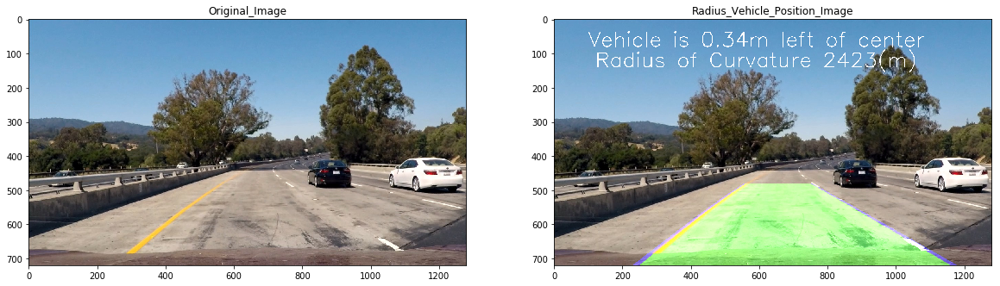

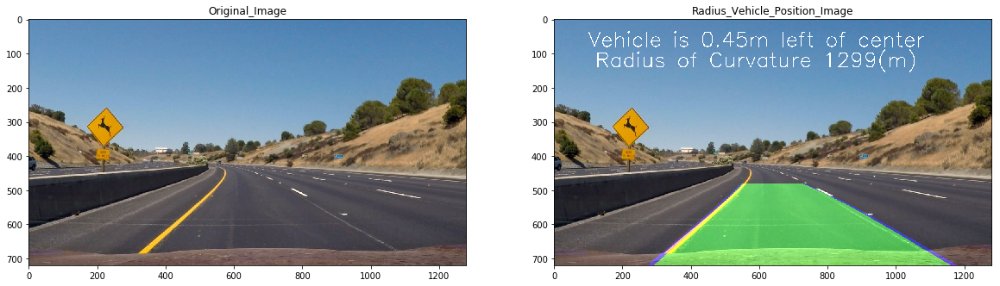

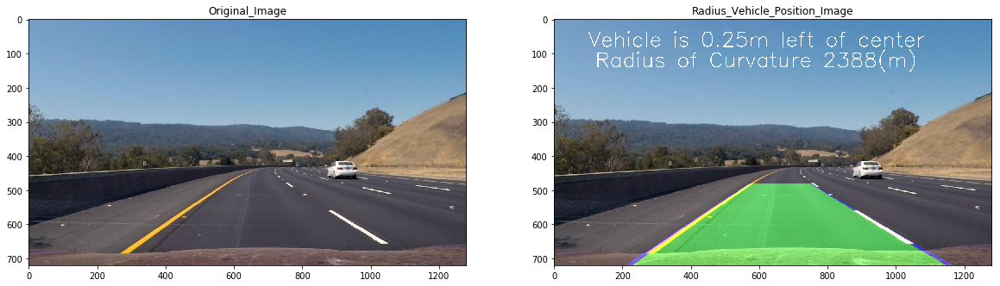

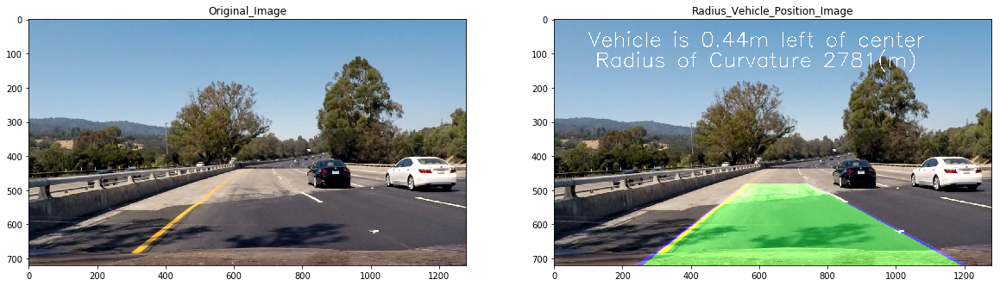

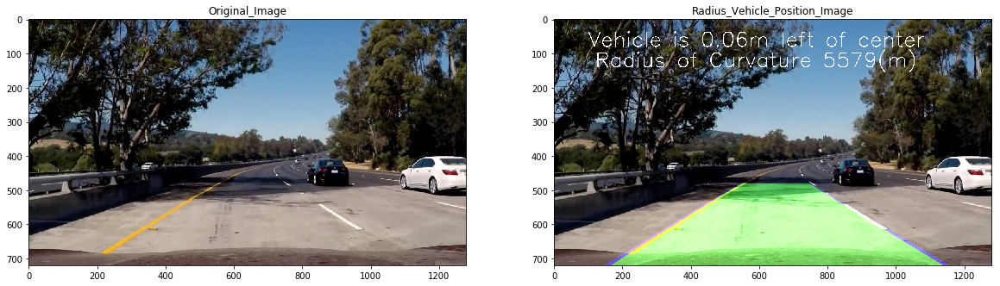

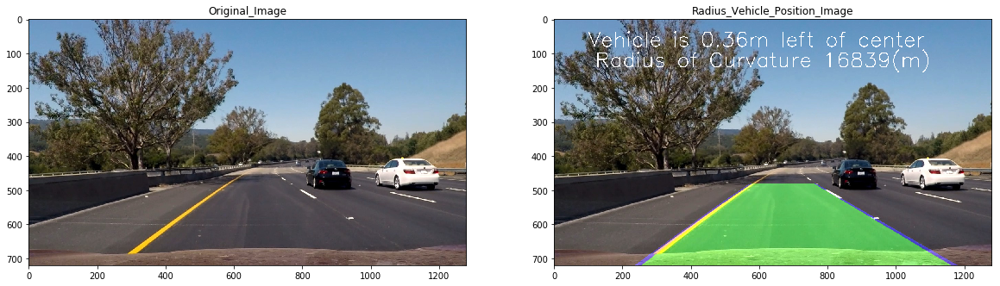

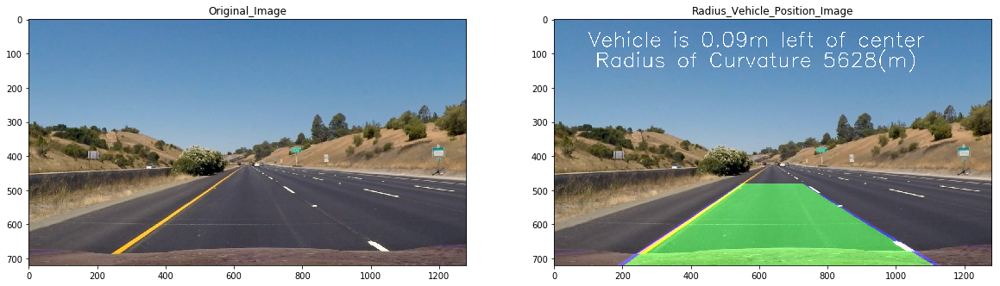

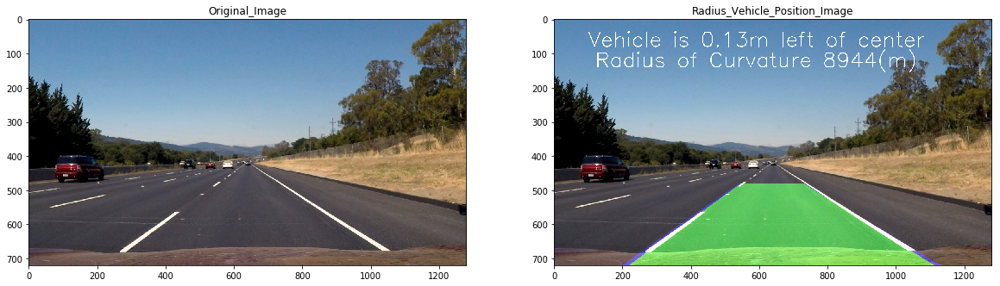

In [16]:
test_images = glob.glob('./test_images/test*.jpg')

for image in test_images:
    img = mpimg.imread(image)
    pimg = find_curv_pos_vehicle(img)
    f, (axis1, axis2) = plt.subplots(1, 2, figsize=(20, 10))
    axis1.imshow(img)
    axis1.set_title('Original_Image')
    axis2.imshow(pimg)
    axis2.set_title('Radius_Vehicle_Position_Image')

### Final pipeline

In [17]:
class Lane():

    def __init__(self):
        # Was the line found in the previous frame?
        self.found = False
        
        # Remember x and y values of lanes in previous frame
        self.X = None
        self.Y = None
        
        # Store recent x intercepts for averaging across frames
        self.x_int = deque(maxlen=10)
        self.top = deque(maxlen=10)
        
        # Remember previous x intercept to compare against current one
        self.lastx_int = None
        self.last_top = None
        
        # Remember radius of curvature
        self.radius = None
        
        # Store recent polynomial coefficients for averaging across frames
        self.fit0 = deque(maxlen=10)
        self.fit1 = deque(maxlen=10)
        self.fit2 = deque(maxlen=10)
        self.fitx = None
        self.pts = []
        
        # Count the number of frames
        self.count = 0
        
    def found_search(self, x, y):
        '''
        This function is applied when the lane lines have been detected in the previous frame.
        It uses a sliding window to search for lane pixels in close proximity (+/- 25 pixels in the x direction)
        around the previous detected polynomial. 
        '''
        xvals = []
        yvals = []
        if self.found == True: 
            i = 720
            j = 630
            while j >= 0:
                yval = np.mean([i,j])
                xval = (np.mean(self.fit0))*yval**2 + (np.mean(self.fit1))*yval + (np.mean(self.fit2))
                x_idx = np.where((((xval - 25) < x)&(x < (xval + 25))&((y > j) & (y < i))))
                x_window, y_window = x[x_idx], y[x_idx]
                if np.sum(x_window) != 0:
                    np.append(xvals, x_window)
                    np.append(yvals, y_window)
                i -= 90
                j -= 90
        if np.sum(xvals) == 0: 
            self.found = False # If no lane pixels were detected then perform blind search
        return xvals, yvals, self.found



In [18]:
def pipeline(image):
    u_img = cv2.undistort(image, mtx, dist, None, mtx)
    p_img = find_curv_pos_vehicle(u_img)
    return p_img

In [19]:
def save_image(image_name, image):
    o_dir = "output_images"
    
    if not os.path.exists(o_dir):
        os.makedirs(o_dir)
    
    mpimg.imsave(o_dir + '/' + image_name, image)

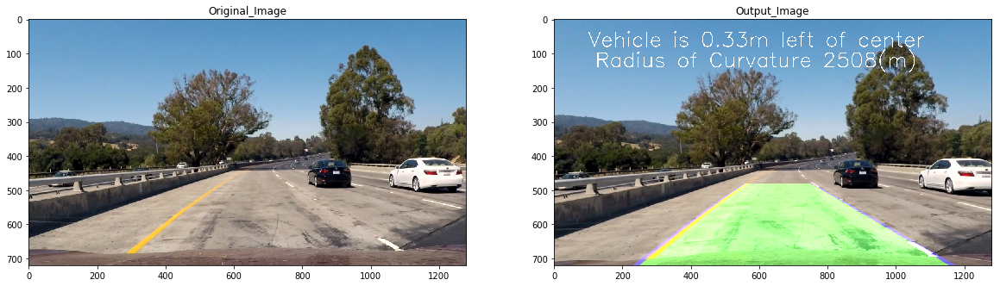

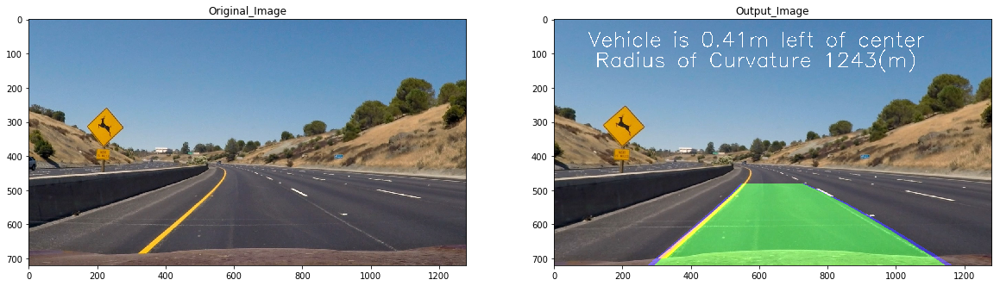

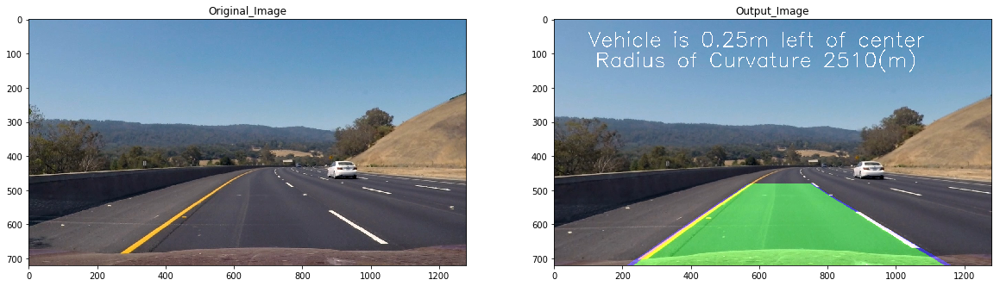

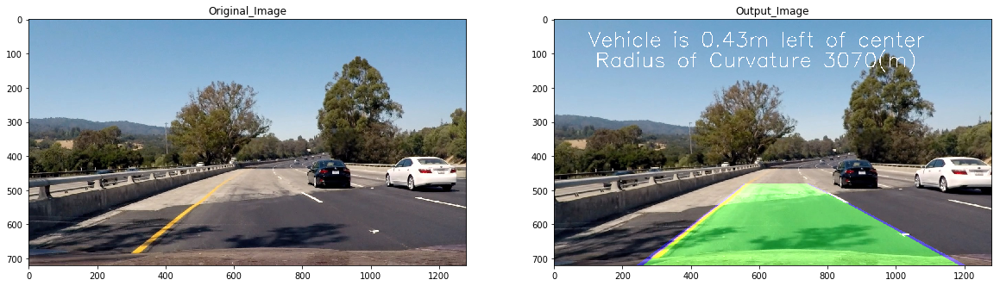

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


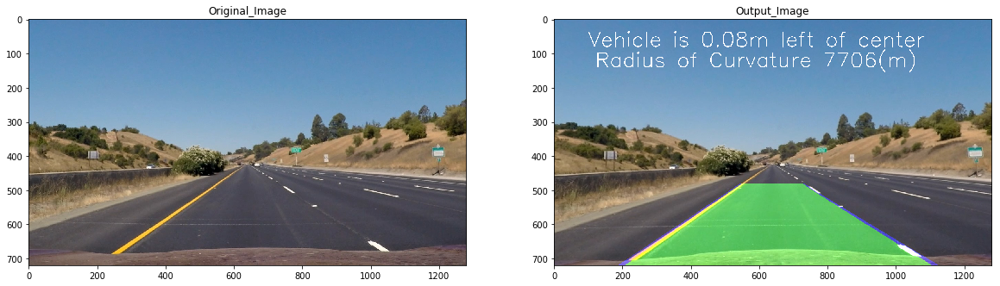

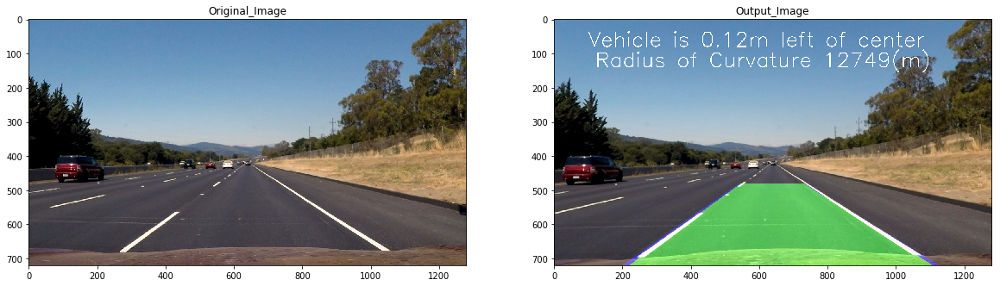

In [20]:
# import os
test_images = glob.glob('./test_images/test*.jpg')

# fig = plt.figure(figsize=(24, 24))
# columns = 2
# rows = 3

for image in test_images:
# for i in range(1, 9):
    img = mpimg.imread(image)
    pimg = pipeline(img)
#     ax = fig.add_subplot(rows, columns, i)
#     ax.title.set_text(os.listdir('test_images')[i-1])
#     save_image(os.listdir('test_images/')[i-1], pimg)
#     plt.imshow(pimg)
# plt.show()
    fig = plt.figure()
    axis1 = fig.add_subplot
    
    f, (axis1, axis2) = plt.subplots(1, 2, figsize=(20, 10))
    axis1.imshow(img)
    axis1.set_title('Original_Image')
    axis2.imshow(pimg)
    axis2.set_title('Output_Image')
    
#     plt.savefig('./output_images/output_image.png')

### Videos processing using pipeline

In [21]:
from moviepy.editor import VideoFileClip

In [23]:
output = 'result.mp4'
clip2 = VideoFileClip("project_video.mp4")
clip1 = clip2.fl_image(pipeline)
clip1.write_videofile(output, audio=False)

[MoviePy] >>>> Building video result.mp4
[MoviePy] Writing video result.mp4


100%|█████████████████████████████████████████████████████████▉| 1260/1261 [04:50<00:00,  4.45it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: result.mp4 

